In [1]:
#!pip install pandas
import pandas as pd 
import io
from matplotlib import pyplot as plt
from matplotlib.ticker import PercentFormatter
import numpy as np
import plotly.express as px
import numpy
import plotly.graph_objects as go


GitHub Link: https://github.com/EricYangg/Smart-Cities-Traffic-Collision

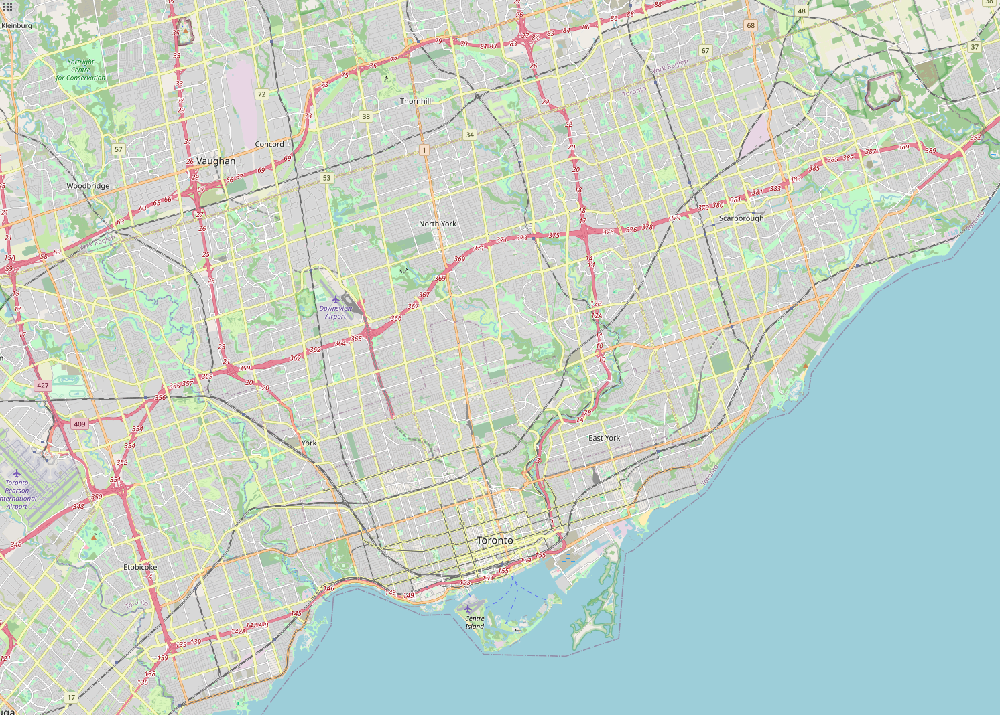

In [2]:
from PIL import Image
import requests
from io import BytesIO

image = 'https://github.com/EricYangg/Smart-Cities-Traffic-Collision/blob/main/Toronto.png?raw=true'
response = requests.get(image)
Im = Image.open(BytesIO(response.content))
Im
#https://www.openstreetmap.org/export#map=13/43.7196/-79.4147 

* FTR is Failed to Remail
* PD is Property Damage
* NSA neighbourhood is 'Not Specified Area', essentially they occour just outside of specified neighbourhoods 

In [2]:
################# https://data.torontopolice.on.ca/datasets/TorontoPS::traffic-collisions-asr-t-tbl-001/explore?location=43.696361%2C-79.388313%2C13.57&showTable=true #################
url ='https://raw.githubusercontent.com/EricYangg/Cyclist-Collisions-Toronto/main/Cyclists.csv'
df = pd.read_csv(url)
df

,X,Y,INDEX_,ACCNUM,YEAR,DATE,TIME,HOUR,STREET1,STREET2,...,PASSENGER,SPEEDING,AG_DRIV,REDLIGHT,ALCOHOL,DISABILITY,POLICE_DIVISION,HOOD_ID,NEIGHBOURHOOD,ObjectId
0,-8.849469e+06,5.415628e+06,7805822,1350654,2013,2013/03/30 04:00:00+00,1214,12,JANE ST,DALRYMPLE DR,...,<Null>,<Null>,Yes,<Null>,<Null>,<Null>,D12,111,Rockcliffe-Smythe (111),1
1,-8.838276e+06,5.411275e+06,7812849,1353734,2013,2013/04/04 04:00:00+00,2000,20,QUEEN St W,SPADINA Ave,...,Yes,<Null>,<Null>,<Null>,<Null>,<Null>,D52,78,Kensington-Chinatown (78),2
2,-8.838276e+06,5.411275e+06,7812850,1353734,2013,2013/04/04 04:00:00+00,2000,20,QUEEN St W,SPADINA Ave,...,Yes,<Null>,<Null>,<Null>,<Null>,<Null>,D52,78,Kensington-Chinatown (78),3
3,-8.838276e+06,5.411275e+06,7812851,1353734,2013,2013/04/04 04:00:00+00,2000,20,QUEEN St W,SPADINA Ave,...,Yes,<Null>,<Null>,<Null>,<Null>,<Null>,D52,78,Kensington-Chinatown (78),4
4,-8.838276e+06,5.411275e+06,7812852,1353734,2013,2013/04/04 04:00:00+00,2000,20,QUEEN St W,SPADINA Ave,...,Yes,<Null>,<Null>,<Null>,<Null>,<Null>,D52,78,Kensington-Chinatown (78),5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1774,-8.852566e+06,5.419712e+06,80951003,8001574808,2018,2018/08/25 04:00:00+00,2300,23,CHURCH ST,CROSS ST,...,<Null>,<Null>,<Null>,<Null>,<Null>,<Null>,D12,113,Weston (113),1775
1775,-8.845371e+06,5.423861e+06,80951038,8001650785,2018,2018/09/06 04:00:00+00,1310,13,ANTHONY RD,NAJIB ABBOUD LANE,...,Yes,<Null>,<Null>,<Null>,<Null>,<Null>,D32,26,Downsview-Roding-CFB (26),1776
1776,-8.845371e+06,5.423861e+06,80951039,8001650785,2018,2018/09/06 04:00:00+00,1310,13,ANTHONY RD,NAJIB ABBOUD LANE,...,Yes,<Null>,<Null>,<Null>,<Null>,<Null>,D32,26,Downsview-Roding-CFB (26),1777
1777,-8.845371e+06,5.423861e+06,80951040,8001650785,2018,2018/09/06 04:00:00+00,1310,13,ANTHONY RD,NAJIB ABBOUD LANE,...,Yes,<Null>,<Null>,<Null>,<Null>,<Null>,D32,26,Downsview-Roding-CFB (26),1778


Since all the data will be grouped by neighbourhood, NSA will be added after grouping if needed

In [4]:
df.columns

Index(['X', 'Y', 'INDEX_', 'ACCNUM', 'YEAR', 'DATE', 'TIME', 'HOUR', 'STREET1',
       'STREET2', 'OFFSET', 'ROAD_CLASS', 'DISTRICT', 'WARDNUM', 'DIVISION',
       'LATITUDE', 'LONGITUDE', 'LOCCOORD', 'ACCLOC', 'TRAFFCTL', 'VISIBILITY',
       'LIGHT', 'RDSFCOND', 'ACCLASS', 'IMPACTYPE', 'INVTYPE', 'INVAGE',
       'INJURY', 'FATAL_NO', 'INITDIR', 'VEHTYPE', 'MANOEUVER', 'DRIVACT',
       'DRIVCOND', 'PEDTYPE', 'PEDACT', 'PEDCOND', 'CYCLISTYPE', 'CYCACT',
       'CYCCOND', 'PEDESTRIAN', 'CYCLIST', 'AUTOMOBILE', 'MOTORCYCLE', 'TRUCK',
       'TRSN_CITY_VEH', 'EMERG_VEH', 'PASSENGER', 'SPEEDING', 'AG_DRIV',
       'REDLIGHT', 'ALCOHOL', 'DISABILITY', 'POLICE_DIVISION', 'HOOD_ID',
       'NEIGHBOURHOOD', 'ObjectId'],
      dtype='object')

#Total Collisions from 2014-2022

In [13]:
total = df.loc[(df['LONGITUDE']!=0)& (df['LATITUDE']!=0) ]
total = total.rename(columns={"LONGITUDE": "Longitude", "LATITUDE": "Latitude"})
total.columns

Index(['X', 'Y', 'INDEX_', 'ACCNUM', 'YEAR', 'DATE', 'TIME', 'HOUR', 'STREET1',
       'STREET2', 'OFFSET', 'ROAD_CLASS', 'DISTRICT', 'WARDNUM', 'DIVISION',
       'Latitude', 'Longitude', 'LOCCOORD', 'ACCLOC', 'TRAFFCTL', 'VISIBILITY',
       'LIGHT', 'RDSFCOND', 'ACCLASS', 'IMPACTYPE', 'INVTYPE', 'INVAGE',
       'INJURY', 'FATAL_NO', 'INITDIR', 'VEHTYPE', 'MANOEUVER', 'DRIVACT',
       'DRIVCOND', 'PEDTYPE', 'PEDACT', 'PEDCOND', 'CYCLISTYPE', 'CYCACT',
       'CYCCOND', 'PEDESTRIAN', 'CYCLIST', 'AUTOMOBILE', 'MOTORCYCLE', 'TRUCK',
       'TRSN_CITY_VEH', 'EMERG_VEH', 'PASSENGER', 'SPEEDING', 'AG_DRIV',
       'REDLIGHT', 'ALCOHOL', 'DISABILITY', 'POLICE_DIVISION', 'HOOD_ID',
       'NEIGHBOURHOOD', 'ObjectId'],
      dtype='object')

longitude and latitude range of dataset to grab image

In [14]:
BBox = [total.Longitude.min(), total.Longitude.max(), total.Latitude.min(), total.Latitude.max()]
print(BBox)

[-79.609165, -79.139507, 43.590289, 43.829145]


In [7]:
total['Neighbourhood'].value_counts()

Waterfront Communities-The Island (77)    18034
Wexford/Maryvale (119)                    12190
West Humber-Clairville (1)                11922
Woburn (137)                              10784
Islington-City Centre West (14)           10616
                                          ...  
Markland Wood (12)                          771
Guildwood (140)                             689
Blake-Jones (69)                            583
Woodbine-Lumsden (60)                       440
Lambton Baby Point (114)                    269
Name: Neighbourhood, Length: 140, dtype: int64

In [8]:
#center of neighbourhood
avg_lon = total.groupby('Neighbourhood', as_index=False)['Longitude'].mean()
avg_lon = avg_lon.rename({'Longitude':'avg_lon'}, axis=1)
avg_lat = total.groupby('Neighbourhood', as_index=False)['Latitude'].mean()
avg_lat = avg_lat.rename({'Latitude':'avg_lat'}, axis=1)

In [9]:
#range of neighbourhood by long and lat 
lon_max = total.groupby('Neighbourhood', as_index=False)['Longitude'].max()
lon_min = total.groupby('Neighbourhood', as_index=False)['Longitude'].min()
#rename
lon_max = lon_max.rename({'Longitude':'max_lon'}, axis=1)
lon_min = lon_min.rename({'Longitude':'min_lon'}, axis=1)
#join
lon_range = lon_max.join(lon_min.set_index('Neighbourhood'), on='Neighbourhood')
lon_range['lon_range'] = lon_range['max_lon'] - lon_range['min_lon']

lat_max = total.groupby('Neighbourhood', as_index=False)['Latitude'].max()
lat_min = total.groupby('Neighbourhood', as_index=False)['Latitude'].min()
#rename
lat_max = lat_max.rename({'Latitude':'max_lat'}, axis=1)
lat_min = lat_min.rename({'Latitude':'min_lat'}, axis=1)
#join
lat_range = lat_max.join(lat_min.set_index('Neighbourhood'), on='Neighbourhood')
lat_range['lat_range'] = lat_range['max_lat'] - lat_range['min_lat']

In [10]:
#number of instances 
c = total['Neighbourhood'].value_counts()
count = pd.DataFrame({'Neighbourhood':c.index, 'count':c.values})
count

,Neighbourhood,count
0,Waterfront Communities-The Island (77),18034
1,Wexford/Maryvale (119),12190
2,West Humber-Clairville (1),11922
3,Woburn (137),10784
4,Islington-City Centre West (14),10616
...,...,...
135,Markland Wood (12),771
136,Guildwood (140),689
137,Blake-Jones (69),583
138,Woodbine-Lumsden (60),440


In [11]:
#join columns together
final_total = pd.DataFrame()

final_total = count.join(avg_lon.set_index('Neighbourhood'), on='Neighbourhood')
final_total = final_total.join(avg_lat.set_index('Neighbourhood'), on='Neighbourhood')
final_total = final_total.join(lat_range.set_index('Neighbourhood'), on='Neighbourhood')
final_total = final_total.join(lon_range.set_index('Neighbourhood'), on='Neighbourhood')
final_total['size'] = (final_total['lat_range'] + final_total['lon_range'])/2 

final_total

,Neighbourhood,count,avg_lon,avg_lat,max_lat,min_lat,lat_range,max_lon,min_lon,lon_range,size
0,Waterfront Communities-The Island (77),18034,-79.385449,43.643619,43.655004,43.633400,0.021604,-79.346622,-79.403971,0.057349,0.039476
1,Wexford/Maryvale (119),12190,-79.299409,43.745958,43.770803,43.724723,0.046080,-79.277819,-79.319670,0.041851,0.043965
2,West Humber-Clairville (1),11922,-79.594841,43.718283,43.757863,43.668767,0.089096,-79.552513,-79.639225,0.086712,0.087904
3,Woburn (137),10784,-79.234256,43.769277,43.786228,43.742382,0.043846,-79.203514,-79.254861,0.051347,0.047597
4,Islington-City Centre West (14),10616,-79.541506,43.629551,43.659581,43.607296,0.052285,-79.514452,-79.565840,0.051387,0.051836
...,...,...,...,...,...,...,...,...,...,...,...
135,Markland Wood (12),771,-79.572417,43.634722,43.644215,43.627162,0.017053,-79.556940,-79.584331,0.027391,0.022222
136,Guildwood (140),689,-79.202142,43.748434,43.757279,43.737573,0.019706,-79.174558,-79.211057,0.036499,0.028102
137,Blake-Jones (69),583,-79.339167,43.677245,43.681483,43.670289,0.011194,-79.330231,-79.344802,0.014571,0.012883
138,Woodbine-Lumsden (60),440,-79.313014,43.693996,43.701523,43.686526,0.014997,-79.304176,-79.318798,0.014622,0.014809


In [12]:
#fig = px.scatter_geo(df, lat='Latitude', lon='Longitude', hover_name="Rue", scope="world", basemap_visible = True, size = df.index)
fig = px.scatter_geo(final_total, lat='avg_lat', lon='avg_lon', hover_name='Neighbourhood', scope="north america", basemap_visible = True, size='size', color='count')
fig.update_geos(fitbounds="locations")
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

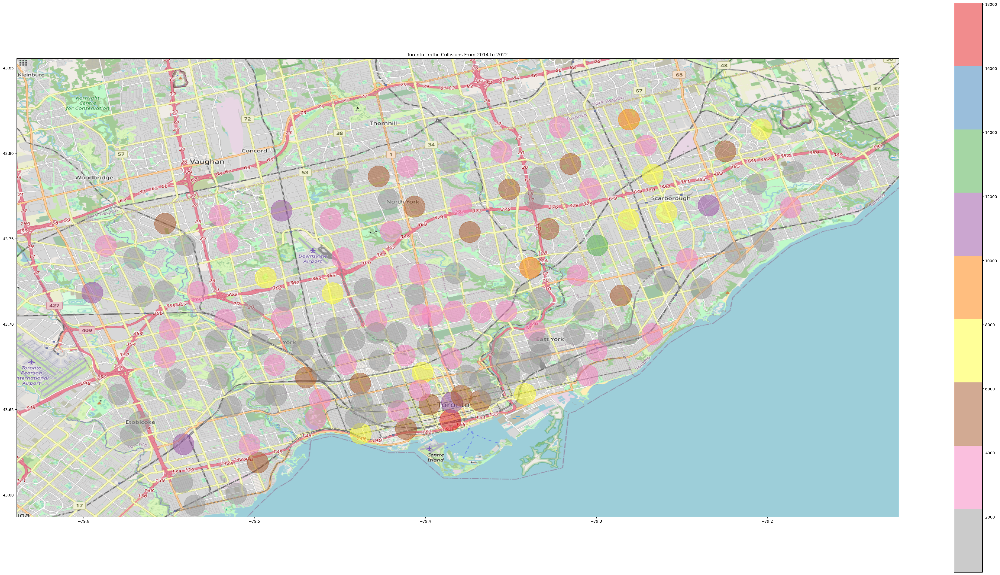

In [13]:
x = 100*(BBox[1]-BBox[0])
y = 100*(BBox[3]-BBox[2])
fig, ax = plt.subplots(figsize = (x,y))

#https://matplotlib.org/stable/tutorials/colors/colormaps.html
p = ax.scatter(final_total.avg_lon, final_total.avg_lat, alpha = 0.5, c=final_total['count'], cmap='Set1_r', s = final_total.size*2)
ax.set_title('Toronto Traffic Collisions From 2014 to 2022')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])

fig.colorbar(p, ax=ax)

ax.imshow(Im, zorder = 0, extent = BBox, aspect = 'equal')


In [14]:
pareto_count = count
pareto_count['cumulative_percent'] = pareto_count['count'].cumsum()/pareto_count['count'].sum()*100
pareto_count

,Neighbourhood,count,cumulative_percent
0,Waterfront Communities-The Island (77),18034,3.822520
1,Wexford/Maryvale (119),12190,6.406335
2,West Humber-Clairville (1),11922,8.933344
3,Woburn (137),10784,11.219141
4,Islington-City Centre West (14),10616,13.469328
...,...,...,...
135,Markland Wood (12),771,99.580104
136,Guildwood (140),689,99.726145
137,Blake-Jones (69),583,99.849719
138,Woodbine-Lumsden (60),440,99.942982


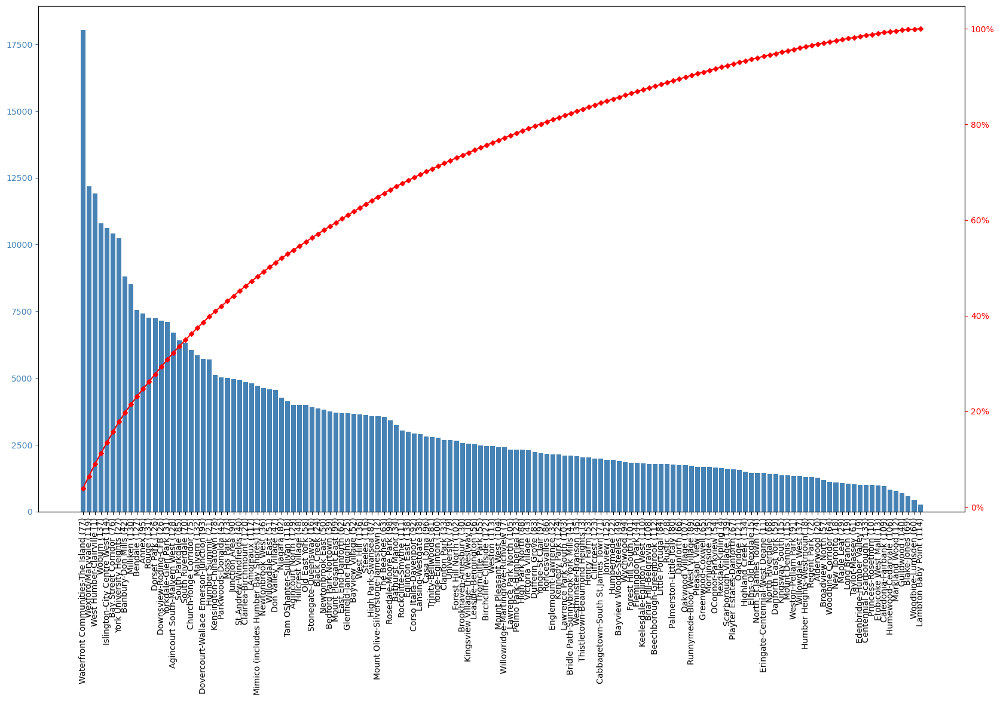

In [15]:
#define aesthetics for plot
color1 = 'steelblue'
color2 = 'red'
line_size = 4

#create basic bar plot
fig, ax = plt.subplots(figsize=(20,11))

ax.bar(pareto_count.index, pareto_count['count'], color=color1)

#add cumulative percentage line to plot
ax2 = ax.twinx()
ax2.plot(pareto_count.Neighbourhood, pareto_count['cumulative_percent'] , color=color2, marker="D", ms=line_size)
ax2.yaxis.set_major_formatter(PercentFormatter())

#specify axis colors
ax.tick_params(axis='y', colors=color1)
ax2.tick_params(axis='y', colors=color2)
ax.tick_params(axis='x', labelrotation=90)
#display Pareto chart
plt.show()

#Collisions Injury Rate

In [16]:
#number of instances 
c = total['Neighbourhood'].value_counts()
count = pd.DataFrame({'Neighbourhood':c.index, 'count':c.values})
count

,Neighbourhood,count
0,Waterfront Communities-The Island (77),18034
1,Wexford/Maryvale (119),12190
2,West Humber-Clairville (1),11922
3,Woburn (137),10784
4,Islington-City Centre West (14),10616
...,...,...
135,Markland Wood (12),771
136,Guildwood (140),689
137,Blake-Jones (69),583
138,Woodbine-Lumsden (60),440


In [17]:
print(total['Fatalities'].value_counts())
print(total['Fatalities'].sum())

0    471298
1       479
2         4
3         2
Name: Fatalities, dtype: int64
493


Fatalities and Injuries

In [18]:
total.shape

(471783, 19)

In [19]:
f = total.loc[(total['Fatalities']>0) | (total['Injury_Collisions']=='YES') ]
f.shape

(67989, 19)

In [20]:
#fatality+injury instances
fatal_inj = pd.DataFrame()
fatal_inj['Neighbourhood'] = f['Neighbourhood']
fatal_inj['Fatalities'] = f['Fatalities']
fatal_inj['Injury_Collisions'] = f['Injury_Collisions']
fatal_inj['Injury_Collisions'] = fatal_inj['Injury_Collisions'].map({'NO':0, 'YES':1}) 

fatal_inj['fatal_inj'] = fatal_inj['Fatalities'] + fatal_inj['Injury_Collisions'] 

fatal_inj['fatal_inj'] = fatal_inj['fatal_inj'].map({1:1, 2:1, 3:1}) #there are a few collisions with more than 1 fatality, however, we are looking at rate of injury or fatality so 0 is no and 1 is yes

fatal_inj = fatal_inj.groupby('Neighbourhood', as_index=False)['fatal_inj'].sum() 
print(fatal_inj)
print(fatal_inj.fatal_inj.sum())

                          Neighbourhood  fatal_inj
0                 Agincourt North (129)        676
1    Agincourt South-Malvern West (128)       1036
2                        Alderwood (20)        204
3                            Annex (95)        894
4                Banbury-Don Mills (42)       1249
..                                  ...        ...
135                       Wychwood (94)        250
136                Yonge-Eglinton (100)        298
137                 Yonge-St.Clair (97)        193
138        York University Heights (27)       1415
139             Yorkdale-Glen Park (31)        730

[140 rows x 2 columns]
67989


Non Fatal Collisions (FTR and PD)

In [21]:
print(total.shape)
print(total.shape[0]-fatal_inj.fatal_inj.sum())

(471783, 19)
403794


In [22]:
nf = total.loc[(total['Fatalities']==0) & (total['Injury_Collisions']=='NO') ]
nf.shape

(403794, 19)

In [23]:
non_fatal = pd.DataFrame()

non_fatal['Neighbourhood'] = nf['Neighbourhood']
non_fatal['FTR_Collisions'] = nf['FTR_Collisions']
non_fatal['PD_Collisions'] = nf['PD_Collisions']

non_fatal['FTR_Collisions'] = non_fatal['FTR_Collisions'].map({'NO':0, 'YES':1})
non_fatal['PD_Collisions'] = non_fatal['PD_Collisions'].map({'NO':0, 'YES':1})
non_fatal['NF_Collisions'] = non_fatal['FTR_Collisions'] + non_fatal['PD_Collisions']
non_fatal['NF_Collisions'] = non_fatal['NF_Collisions'].map({0:0, 1:1, 2:1})

final_non_fatal = non_fatal.groupby('Neighbourhood', as_index=False)['NF_Collisions'].sum() 
print(final_non_fatal)
print(final_non_fatal.NF_Collisions.sum())

                          Neighbourhood  NF_Collisions
0                 Agincourt North (129)           3324
1    Agincourt South-Malvern West (128)           5665
2                        Alderwood (20)           1056
3                            Annex (95)           6531
4                Banbury-Don Mills (42)           7555
..                                  ...            ...
135                       Wychwood (94)           1604
136                Yonge-Eglinton (100)           2479
137                 Yonge-St.Clair (97)           1994
138        York University Heights (27)           8813
139             Yorkdale-Glen Park (31)           6367

[140 rows x 2 columns]
403794


Fatal + Injury Rate

In [24]:
fatal_inj_rate = pd.DataFrame()

#final_total.join(avg_lat.set_index('Neighbourhood'), on='Neighbourhood')

fatal_inj_rate['Neighbourhood'] = fatal_inj['Neighbourhood']
fatal_inj_rate['fatal_inj_rate'] = fatal_inj['fatal_inj']/(fatal_inj['fatal_inj'] + final_non_fatal['NF_Collisions'])*100
#fatal_inj_rate['fatal_inj_rate'] = fatal_inj_rate['fatal_inj_rate'].astype(int)
fatal_inj_rate

,Neighbourhood,fatal_inj_rate
0,Agincourt North (129),16.900000
1,Agincourt South-Malvern West (128),15.460379
2,Alderwood (20),16.190476
3,Annex (95),12.040404
4,Banbury-Don Mills (42),14.186733
...,...,...
135,Wychwood (94),13.484358
136,Yonge-Eglinton (100),10.731005
137,Yonge-St.Clair (97),8.824874
138,York University Heights (27),13.834572


In [25]:
fatal_inj_rate.max()

Neighbourhood     Yorkdale-Glen Park (31)
fatal_inj_rate                  21.544118
dtype: object

In [26]:
#join columns together
final_fatal_inj_rate = pd.DataFrame()

final_fatal_inj_rate = fatal_inj_rate.join(avg_lon.set_index('Neighbourhood'), on='Neighbourhood')
final_fatal_inj_rate = final_fatal_inj_rate.join(avg_lat.set_index('Neighbourhood'), on='Neighbourhood')
final_fatal_inj_rate = final_fatal_inj_rate.join(lat_range.set_index('Neighbourhood'), on='Neighbourhood')
final_fatal_inj_rate = final_fatal_inj_rate.join(lon_range.set_index('Neighbourhood'), on='Neighbourhood')
final_fatal_inj_rate['size'] = (final_fatal_inj_rate['lat_range'] + final_fatal_inj_rate['lon_range'])/2 

final_fatal_inj_rate

,Neighbourhood,fatal_inj_rate,avg_lon,avg_lat,max_lat,min_lat,lat_range,max_lon,min_lon,lon_range,size
0,Agincourt North (129),16.900000,-79.270928,43.804340,43.817987,43.790578,0.027409,-79.238450,-79.289975,0.051525,0.039467
1,Agincourt South-Malvern West (128),15.460379,-79.267010,43.787455,43.803751,43.775008,0.028744,-79.235250,-79.291665,0.056415,0.042579
2,Alderwood (20),16.190476,-79.542206,43.607229,43.616953,43.592533,0.024420,-79.526641,-79.560664,0.034023,0.029221
3,Annex (95),12.040404,-79.401626,43.671413,43.680556,43.663585,0.016971,-79.386748,-79.421505,0.034757,0.025864
4,Banbury-Don Mills (42),14.186733,-79.338673,43.732816,43.755812,43.717099,0.038713,-79.327121,-79.380619,0.053498,0.046105
...,...,...,...,...,...,...,...,...,...,...,...
135,Wychwood (94),13.484358,-79.426924,43.678567,43.683167,43.670715,0.012453,-79.414810,-79.435651,0.020841,0.016647
136,Yonge-Eglinton (100),10.731005,-79.403111,43.705307,43.713530,43.695974,0.017556,-79.396164,-79.411092,0.014927,0.016241
137,Yonge-St.Clair (97),8.824874,-79.398539,43.687863,43.697480,43.678164,0.019316,-79.391300,-79.405571,0.014272,0.016794
138,York University Heights (27),13.834572,-79.484140,43.766314,43.787284,43.743107,0.044177,-79.463349,-79.516970,0.053621,0.048899


In [27]:
#fig = px.scatter_geo(df, lat='Latitude', lon='Longitude', hover_name="Rue", scope="world", basemap_visible = True, size = df.index)
fig = px.scatter_geo(final_fatal_inj_rate, lat='avg_lat', lon='avg_lon', hover_name='Neighbourhood', scope="north america", basemap_visible = True, color='fatal_inj_rate', size='size')
fig.update_geos(fitbounds="locations")
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

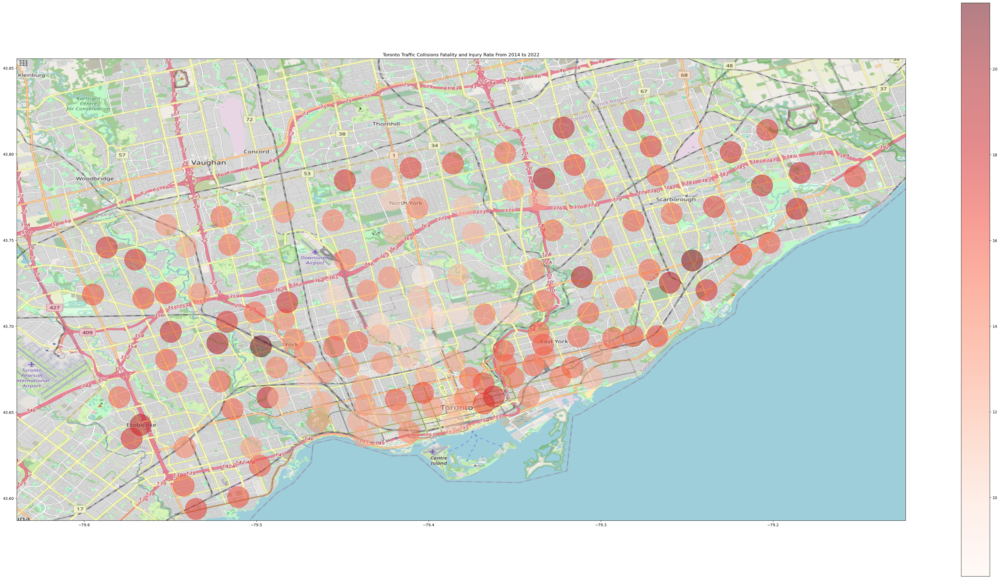

In [28]:
x = 100*(BBox[1]-BBox[0])
y = 100*(BBox[3]-BBox[2])
fig, ax = plt.subplots(figsize = (x,y))

#https://matplotlib.org/stable/tutorials/colors/colormaps.html
p = ax.scatter(final_fatal_inj_rate.avg_lon, final_fatal_inj_rate.avg_lat, alpha = 0.5, c=final_fatal_inj_rate['fatal_inj_rate'], cmap='Reds', s = final_fatal_inj_rate.size*2)
ax.set_title('Toronto Traffic Collisions Fatality and Injury Rate From 2014 to 2022')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])

fig.colorbar(p, ax=ax)

ax.imshow(Im, zorder = 0, extent = BBox, aspect = 'equal')


In [29]:
pareto_inj = fatal_inj_rate.sort_values(by='fatal_inj_rate', ascending=False)
pareto_inj['cumulative_percent'] = pareto_inj['fatal_inj_rate'].cumsum()/pareto_inj['fatal_inj_rate'].sum()*100
pareto_inj

,Neighbourhood,fatal_inj_rate,cumulative_percent
80,Mount Dennis (115),21.544118,1.042846
37,Eglinton East (138),21.068447,2.062668
53,Humber Heights-Westmount (8),19.600307,3.011424
121,Victoria Village (43),19.389978,3.949999
98,Pleasant View (46),19.141324,4.876537
...,...,...,...
83,Mount Pleasant West (104),9.887827,98.233708
43,Forest Hill North (102),9.841629,98.710094
82,Mount Pleasant East (99),9.659091,99.177644
137,Yonge-St.Clair (97),8.824874,99.604813


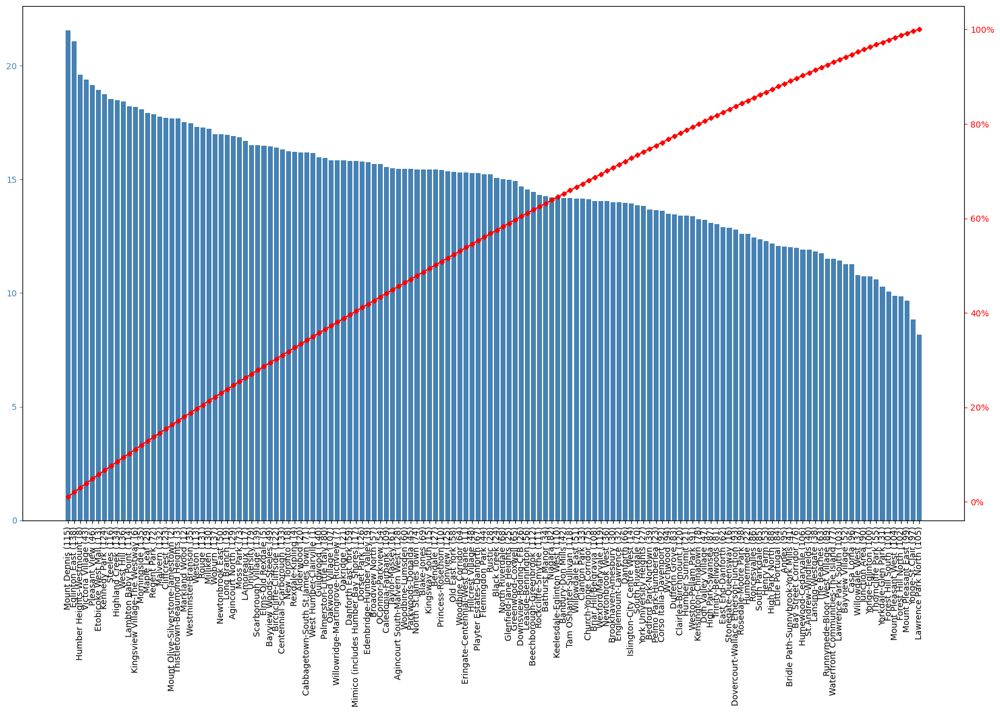

In [30]:
#define aesthetics for plot
color1 = 'steelblue'
color2 = 'red'
line_size = 4

#create basic bar plot
fig, ax = plt.subplots(figsize=(20,11))
ax.bar(pareto_inj.Neighbourhood, pareto_inj['fatal_inj_rate'], color=color1)

#add cumulative percentage line to plot
ax2 = ax.twinx()
ax2.plot(pareto_inj.Neighbourhood, pareto_inj['cumulative_percent'] , color=color2, marker="D", ms=line_size)
ax2.yaxis.set_major_formatter(PercentFormatter())

#specify axis colors
ax.tick_params(axis='y', colors=color1)
ax2.tick_params(axis='y', colors=color2)
ax.tick_params(axis='x', labelrotation=90)
#display Pareto chart
plt.show()

#Collision Every 3 years 

In [31]:
total = df.loc[(df['Longitude']!=0)& (df['Latitude']!=0) & (df['Neighbourhood']!='NSA')] #471783 rows
#total = total.loc[ (total['Fatalities']>0) | (total['Injury_Collisions']=='YES')  | (total['FTR_Collisions']=='YES')  | (total['PD_Collisions']=='YES') ] #same rows
total

,X,Y,OBJECTID,EventUniqueId,OccurrenceDate,Month,Day_of_Week,Year,Hour,Division,Atom,Neighbourhood,Fatalities,Injury_Collisions,FTR_Collisions,PD_Collisions,Longitude,Latitude,ObjectId2
1,-8.833635e+06,5.414591e+06,402,GO-20148000205,2014/01/03 05:00:00+00,January,Friday,2014,12,D54/D55,68,North Riverdale (68),0,NO,NO,YES,-79.353893,43.670491,2
3,-8.838998e+06,5.413446e+06,404,GO-20148000208,2014/01/03 05:00:00+00,January,Friday,2014,11,D52,79,University (79),0,NO,NO,YES,-79.402070,43.663052,4
4,-8.840999e+06,5.434235e+06,405,GO-20148000209,2014/01/03 05:00:00+00,January,Friday,2014,13,D32,50,Newtonbrook East (50),0,NO,NO,YES,-79.420043,43.798000,5
5,-8.843873e+06,5.421313e+06,406,GO-20148000210,2014/01/03 05:00:00+00,January,Friday,2014,10,D13,31,Yorkdale-Glen Park (31),0,NO,NO,YES,-79.445864,43.714152,6
6,-8.857320e+06,5.420936e+06,407,GO-20148000211,2014/01/03 05:00:00+00,January,Friday,2014,10,D23,4,Rexdale-Kipling (4),0,NO,NO,YES,-79.566663,43.711705,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
553775,-8.825943e+06,5.426453e+06,553220,GO-20228022848,2022/06/27 04:00:00+00,June,Monday,2022,17,D41,126,Dorset Park (126),0,NO,NO,YES,-79.284796,43.747518,553776
553776,-8.843559e+06,5.415741e+06,553221,GO-20228022849,2022/06/27 04:00:00+00,June,Monday,2022,7,D13,92,Corso Italia-Davenport (92),0,YES,NO,NO,-79.443043,43.677962,553777
553777,-8.820438e+06,5.420244e+06,553222,GO-20228022856,2022/06/27 04:00:00+00,June,Monday,2022,23,D41,123,Cliffcrest (123),0,NO,NO,YES,-79.235346,43.707215,553778
553778,-8.836129e+06,5.420474e+06,553223,GO-20228022858,2022/06/27 04:00:00+00,June,Monday,2022,18,D53,99,Mount Pleasant East (99),0,NO,NO,YES,-79.376298,43.708705,553779


longitude and latitude range of dataset to grab image

In [32]:
#center of neighbourhood
avg_lon = total.groupby('Neighbourhood', as_index=False)['Longitude'].mean()
avg_lon = avg_lon.rename({'Longitude':'avg_lon'}, axis=1)
avg_lat = total.groupby('Neighbourhood', as_index=False)['Latitude'].mean()
avg_lat = avg_lat.rename({'Latitude':'avg_lat'}, axis=1)

In [33]:
#range of neighbourhood by long and lat 
lon_max = total.groupby('Neighbourhood', as_index=False)['Longitude'].max()
lon_min = total.groupby('Neighbourhood', as_index=False)['Longitude'].min()
#rename
lon_max = lon_max.rename({'Longitude':'max_lon'}, axis=1)
lon_min = lon_min.rename({'Longitude':'min_lon'}, axis=1)
#join
lon_range = lon_max.join(lon_min.set_index('Neighbourhood'), on='Neighbourhood')
lon_range['lon_range'] = lon_range['max_lon'] - lon_range['min_lon']

lat_max = total.groupby('Neighbourhood', as_index=False)['Latitude'].max()
lat_min = total.groupby('Neighbourhood', as_index=False)['Latitude'].min()
#rename
lat_max = lat_max.rename({'Latitude':'max_lat'}, axis=1)
lat_min = lat_min.rename({'Latitude':'min_lat'}, axis=1)
#join
lat_range = lat_max.join(lat_min.set_index('Neighbourhood'), on='Neighbourhood')
lat_range['lat_range'] = lat_range['max_lat'] - lat_range['min_lat']

In [34]:
total_14_16 = total.loc[(total['Year']>=2014)& (total['Year']<=2016)]
total_17_19 = total.loc[(total['Year']>=2017)& (total['Year']<=2019)]
total_20_22 = total.loc[(total['Year']>=2020)& (total['Year']<=2022)]

In [35]:
#number of instances 
c = total_14_16['Neighbourhood'].value_counts()
count_14_16 = pd.DataFrame({'Neighbourhood':c.index, 'count':c.values})

#join columns together
final_total_14_16 = pd.DataFrame()

final_total_14_16 = count_14_16.join(avg_lon.set_index('Neighbourhood'), on='Neighbourhood')
final_total_14_16 = final_total_14_16.join(avg_lat.set_index('Neighbourhood'), on='Neighbourhood')
final_total_14_16 = final_total_14_16.join(lat_range.set_index('Neighbourhood'), on='Neighbourhood')
final_total_14_16 = final_total_14_16.join(lon_range.set_index('Neighbourhood'), on='Neighbourhood')
final_total_14_16['size'] = (final_total_14_16['lat_range'] + final_total_14_16['lon_range'])/2 

final_total_14_16

,Neighbourhood,count,avg_lon,avg_lat,max_lat,min_lat,lat_range,max_lon,min_lon,lon_range,size
0,Waterfront Communities-The Island (77),6271,-79.385449,43.643619,43.655004,43.633400,0.021604,-79.346622,-79.403971,0.057349,0.039476
1,Wexford/Maryvale (119),4432,-79.299409,43.745958,43.770803,43.724723,0.046080,-79.277819,-79.319670,0.041851,0.043965
2,West Humber-Clairville (1),4288,-79.594841,43.718283,43.757863,43.668767,0.089096,-79.552513,-79.639225,0.086712,0.087904
3,Islington-City Centre West (14),4162,-79.541506,43.629551,43.659581,43.607296,0.052285,-79.514452,-79.565840,0.051387,0.051836
4,York University Heights (27),4024,-79.484140,43.766314,43.787284,43.743107,0.044177,-79.463349,-79.516970,0.053621,0.048899
...,...,...,...,...,...,...,...,...,...,...,...
135,Markland Wood (12),308,-79.572417,43.634722,43.644215,43.627162,0.017053,-79.556940,-79.584331,0.027391,0.022222
136,Guildwood (140),268,-79.202142,43.748434,43.757279,43.737573,0.019706,-79.174558,-79.211057,0.036499,0.028102
137,Blake-Jones (69),202,-79.339167,43.677245,43.681483,43.670289,0.011194,-79.330231,-79.344802,0.014571,0.012883
138,Woodbine-Lumsden (60),182,-79.313014,43.693996,43.701523,43.686526,0.014997,-79.304176,-79.318798,0.014622,0.014809


In [36]:
#number of instances 
c = total_17_19['Neighbourhood'].value_counts()
count_17_19 = pd.DataFrame({'Neighbourhood':c.index, 'count':c.values})

#join columns together
final_total_17_19 = pd.DataFrame()

final_total_17_19 = count_17_19.join(avg_lon.set_index('Neighbourhood'), on='Neighbourhood')
final_total_17_19 = final_total_17_19.join(avg_lat.set_index('Neighbourhood'), on='Neighbourhood')
final_total_17_19 = final_total_17_19.join(lat_range.set_index('Neighbourhood'), on='Neighbourhood')
final_total_17_19 = final_total_17_19.join(lon_range.set_index('Neighbourhood'), on='Neighbourhood')
final_total_17_19['size'] = (final_total_17_19['lat_range'] + final_total_17_19['lon_range'])/2 

final_total_17_19

,Neighbourhood,count,avg_lon,avg_lat,max_lat,min_lat,lat_range,max_lon,min_lon,lon_range,size
0,Waterfront Communities-The Island (77),8135,-79.385449,43.643619,43.655004,43.633400,0.021604,-79.346622,-79.403971,0.057349,0.039476
1,West Humber-Clairville (1),5112,-79.594841,43.718283,43.757863,43.668767,0.089096,-79.552513,-79.639225,0.086712,0.087904
2,Wexford/Maryvale (119),5067,-79.299409,43.745958,43.770803,43.724723,0.046080,-79.277819,-79.319670,0.041851,0.043965
3,Bay Street Corridor (76),4823,-79.384408,43.653992,43.669974,43.644775,0.025199,-79.376935,-79.394102,0.017168,0.021184
4,Woburn (137),4659,-79.234256,43.769277,43.786228,43.742382,0.043846,-79.203514,-79.254861,0.051347,0.047597
...,...,...,...,...,...,...,...,...,...,...,...
135,Humewood-Cedarvale (106),278,-79.428754,43.694624,43.700993,43.681949,0.019044,-79.418262,-79.437149,0.018887,0.018966
136,Guildwood (140),274,-79.202142,43.748434,43.757279,43.737573,0.019706,-79.174558,-79.211057,0.036499,0.028102
137,Blake-Jones (69),227,-79.339167,43.677245,43.681483,43.670289,0.011194,-79.330231,-79.344802,0.014571,0.012883
138,Woodbine-Lumsden (60),158,-79.313014,43.693996,43.701523,43.686526,0.014997,-79.304176,-79.318798,0.014622,0.014809


In [37]:
#number of instances 
c = total_20_22['Neighbourhood'].value_counts()
count_20_22 = pd.DataFrame({'Neighbourhood':c.index, 'count':c.values})

#join columns together
final_total_20_22 = pd.DataFrame()

final_total_20_22 = count_20_22.join(avg_lon.set_index('Neighbourhood'), on='Neighbourhood')
final_total_20_22 = final_total_20_22.join(avg_lat.set_index('Neighbourhood'), on='Neighbourhood')
final_total_20_22 = final_total_20_22.join(lat_range.set_index('Neighbourhood'), on='Neighbourhood')
final_total_20_22 = final_total_20_22.join(lon_range.set_index('Neighbourhood'), on='Neighbourhood')
final_total_20_22['size'] = (final_total_20_22['lat_range'] + final_total_20_22['lon_range'])/2 

final_total_20_22

,Neighbourhood,count,avg_lon,avg_lat,max_lat,min_lat,lat_range,max_lon,min_lon,lon_range,size
0,Waterfront Communities-The Island (77),3628,-79.385449,43.643619,43.655004,43.633400,0.021604,-79.346622,-79.403971,0.057349,0.039476
1,Wexford/Maryvale (119),2691,-79.299409,43.745958,43.770803,43.724723,0.046080,-79.277819,-79.319670,0.041851,0.043965
2,West Humber-Clairville (1),2522,-79.594841,43.718283,43.757863,43.668767,0.089096,-79.552513,-79.639225,0.086712,0.087904
3,Woburn (137),2169,-79.234256,43.769277,43.786228,43.742382,0.043846,-79.203514,-79.254861,0.051347,0.047597
4,York University Heights (27),2104,-79.484140,43.766314,43.787284,43.743107,0.044177,-79.463349,-79.516970,0.053621,0.048899
...,...,...,...,...,...,...,...,...,...,...,...
135,Humewood-Cedarvale (106),162,-79.428754,43.694624,43.700993,43.681949,0.019044,-79.418262,-79.437149,0.018887,0.018966
136,Blake-Jones (69),154,-79.339167,43.677245,43.681483,43.670289,0.011194,-79.330231,-79.344802,0.014571,0.012883
137,Guildwood (140),147,-79.202142,43.748434,43.757279,43.737573,0.019706,-79.174558,-79.211057,0.036499,0.028102
138,Woodbine-Lumsden (60),100,-79.313014,43.693996,43.701523,43.686526,0.014997,-79.304176,-79.318798,0.014622,0.014809


In [38]:
#fig = px.scatter_geo(df, lat='Latitude', lon='Longitude', hover_name="Rue", scope="world", basemap_visible = True, size = df.index)
fig = px.scatter_geo(final_total_14_16, lat='avg_lat', lon='avg_lon', hover_name='Neighbourhood', scope="north america", basemap_visible = True, size='size', color='count')
fig.update_geos(fitbounds="locations")
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [39]:
#fig = px.scatter_geo(df, lat='Latitude', lon='Longitude', hover_name="Rue", scope="world", basemap_visible = True, size = df.index)
fig = px.scatter_geo(final_total_17_19, lat='avg_lat', lon='avg_lon', hover_name='Neighbourhood', scope="north america", basemap_visible = True, size='size', color='count')
fig.update_geos(fitbounds="locations")
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [40]:
#fig = px.scatter_geo(df, lat='Latitude', lon='Longitude', hover_name="Rue", scope="world", basemap_visible = True, size = df.index)
fig = px.scatter_geo(final_total_20_22, lat='avg_lat', lon='avg_lon', hover_name='Neighbourhood', scope="north america", basemap_visible = True, size='size', color='count')
fig.update_geos(fitbounds="locations")
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

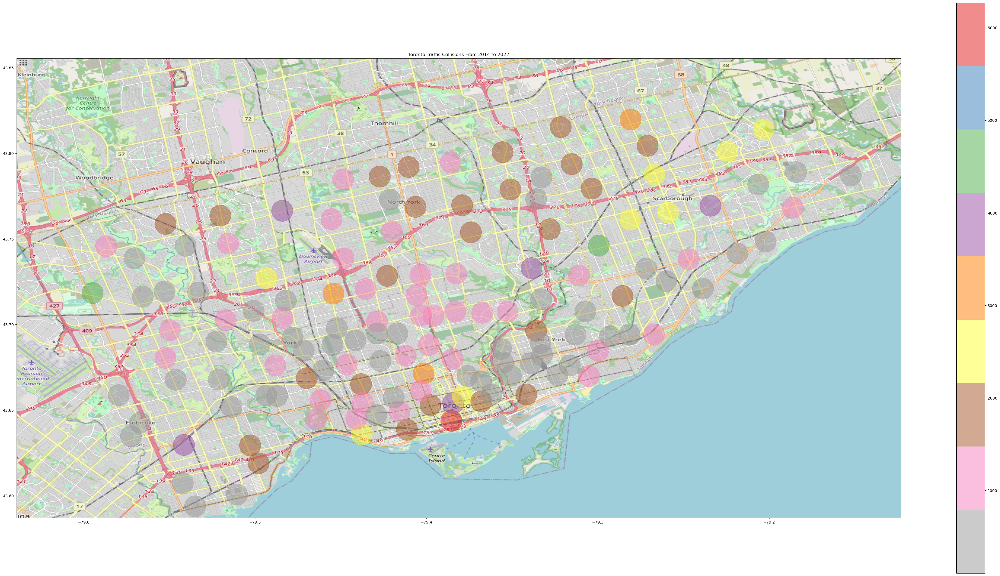

In [41]:
x = 100*(BBox[1]-BBox[0])
y = 100*(BBox[3]-BBox[2])
fig, ax = plt.subplots(figsize = (x,y))

#https://matplotlib.org/stable/tutorials/colors/colormaps.html
p = ax.scatter(final_total_14_16.avg_lon, final_total_14_16.avg_lat, alpha = 0.5, c=final_total_14_16['count'], cmap='Set1_r', s = final_total_14_16.size*2)
ax.set_title('Toronto Traffic Collisions From 2014 to 2022')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])

fig.colorbar(p, ax=ax)

ax.imshow(Im, zorder = 0, extent = BBox, aspect = 'equal')


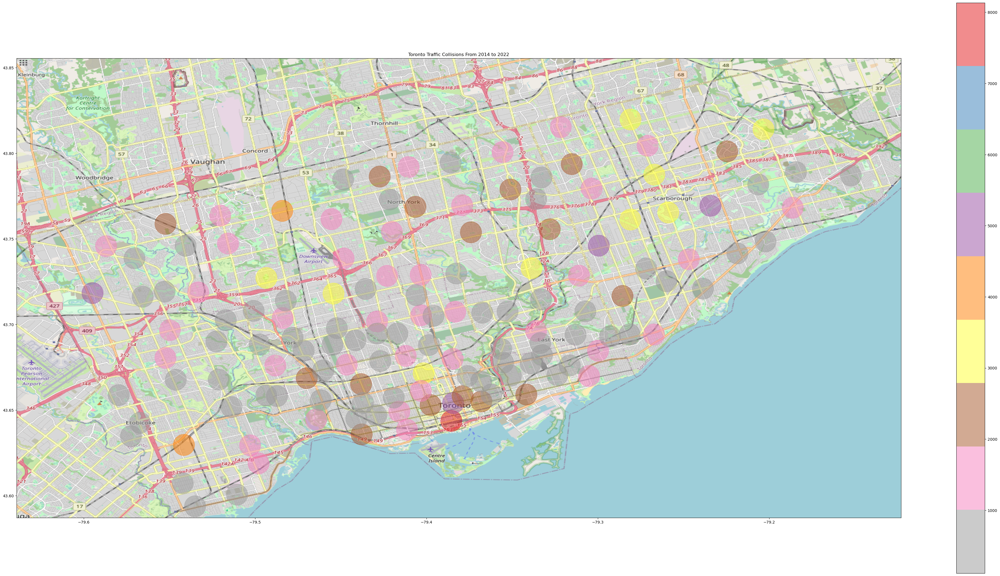

In [42]:
x = 100*(BBox[1]-BBox[0])
y = 100*(BBox[3]-BBox[2])
fig, ax = plt.subplots(figsize = (x,y))

#https://matplotlib.org/stable/tutorials/colors/colormaps.html
p = ax.scatter(final_total_17_19.avg_lon, final_total_17_19.avg_lat, alpha = 0.5, c=final_total_17_19['count'], cmap='Set1_r', s = final_total_17_19.size*2)
ax.set_title('Toronto Traffic Collisions From 2014 to 2022')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])

fig.colorbar(p, ax=ax)

ax.imshow(Im, zorder = 0, extent = BBox, aspect = 'equal')


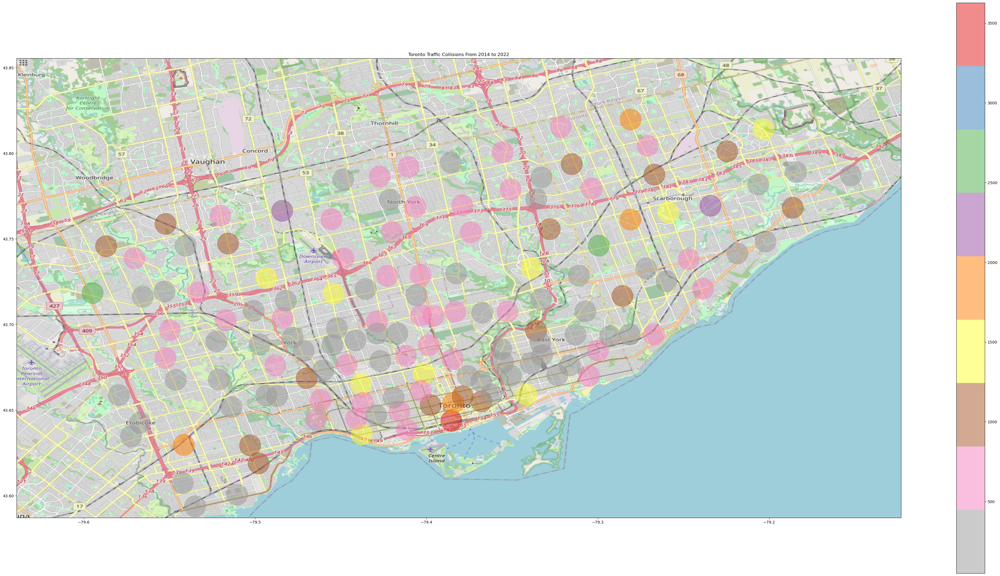

In [43]:
x = 100*(BBox[1]-BBox[0])
y = 100*(BBox[3]-BBox[2])
fig, ax = plt.subplots(figsize = (x,y))

#https://matplotlib.org/stable/tutorials/colors/colormaps.html
p = ax.scatter(final_total_20_22.avg_lon, final_total_20_22.avg_lat, alpha = 0.5, c=final_total_20_22['count'], cmap='Set1_r', s = final_total_20_22.size*2)
ax.set_title('Toronto Traffic Collisions From 2014 to 2022')
ax.set_xlim(BBox[0],BBox[1])
ax.set_ylim(BBox[2],BBox[3])

fig.colorbar(p, ax=ax)

ax.imshow(Im, zorder = 0, extent = BBox, aspect = 'equal')


#Count by Daytime (6AM to 6PM) vs Nighttime (6PM to 6AM)

In [44]:
day_night = pd.DataFrame()

day_night['Neighbourhood'] = total['Neighbourhood']
day_night['Year'] = total['Year']
day_night['Hour'] = total['Hour']

conditions = [
    (day_night['Hour'] < 6),
    (day_night['Hour'] >= 6) & (day_night['Hour'] < 18),
    (day_night['Hour'] >= 18) & (day_night['Hour'] <= 24)
]

values = ['Night', 'Day', 'Night']

day_night['Day_Night'] = np.select(conditions, values)
day_night = day_night.drop(columns=['Neighbourhood','Hour'])
day_night


,Year,Day_Night
1,2014,Day
3,2014,Day
4,2014,Day
5,2014,Day
6,2014,Day
...,...,...
553775,2022,Day
553776,2022,Day
553777,2022,Night
553778,2022,Night


In [45]:
day_night['Day_Night'].value_counts()

Day      342786
Night    128997
Name: Day_Night, dtype: int64

In [46]:
#number of instances 
day_night_final = day_night.value_counts()
day_night_final = pd.DataFrame(day_night_final).reset_index()
day_night_final.columns = ['Year', 'Day_Night', 'Count']
day_night_final = day_night_final.sort_values(by=['Year'])
day_night_final = pd.DataFrame(day_night_final).reset_index()
day_night_final = day_night_final.drop(columns=['index'])
day_night_final

,Year,Day_Night,Count
0,2014,Night,13848
1,2014,Day,40961
2,2015,Day,44718
3,2015,Night,15615
4,2016,Day,46351
5,2016,Night,17158
6,2017,Day,47856
7,2017,Night,17726
8,2018,Day,47282
9,2018,Night,17937


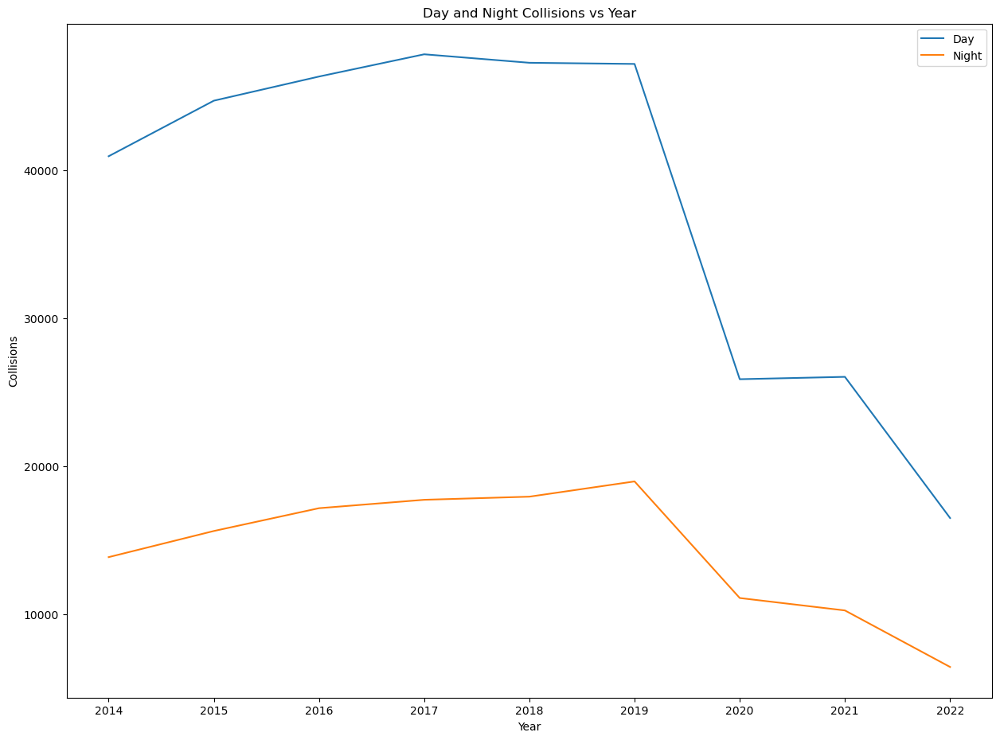

In [47]:
plt.figure(figsize=(15,11))
plt.plot(day_night_final['Year'].loc[day_night_final['Day_Night']=='Day'], day_night_final['Count'].loc[day_night_final['Day_Night']=='Day'], label = "Day")
plt.plot(day_night_final['Year'].loc[day_night_final['Day_Night']=='Night'], day_night_final['Count'].loc[day_night_final['Day_Night']=='Night'], label = "Night")

plt.title('Day and Night Collisions vs Year')
plt.xlabel('Year')
plt.ylabel('Collisions')
plt.legend()
plt.show()

#Count by Day of Week

In [48]:
DoW = pd.DataFrame()

DoW['Year'] = total['Year']
DoW['DoW'] = total['Day_of_Week']

DoW


,Year,DoW
1,2014,Friday
3,2014,Friday
4,2014,Friday
5,2014,Friday
6,2014,Friday
...,...,...
553775,2022,Monday
553776,2022,Monday
553777,2022,Monday
553778,2022,Monday


In [49]:
DoW.value_counts()

Year  DoW      
2017  Friday       11117
2018  Friday       10956
2019  Friday       10726
      Wednesday    10640
      Thursday     10635
                   ...  
2022  Tuesday       3500
      Saturday      3234
      Wednesday     3196
      Monday        3073
      Sunday        2411
Length: 63, dtype: int64

In [50]:
#number of instances 
DoW_final = DoW.value_counts()
DoW_final = pd.DataFrame(DoW_final).reset_index()
DoW_final.columns = ['Year', 'DoW', 'Count']
DoW_final = DoW_final.sort_values(by=['Year'])
DoW_final = pd.DataFrame(DoW_final).reset_index()
DoW_final = DoW_final.drop(columns=['index'])
DoW_final

,Year,DoW,Count
0,2014,Friday,8919
1,2014,Sunday,5345
2,2014,Thursday,8701
3,2014,Saturday,7094
4,2014,Monday,7421
...,...,...,...
58,2022,Thursday,3568
59,2022,Tuesday,3500
60,2022,Saturday,3234
61,2022,Wednesday,3196


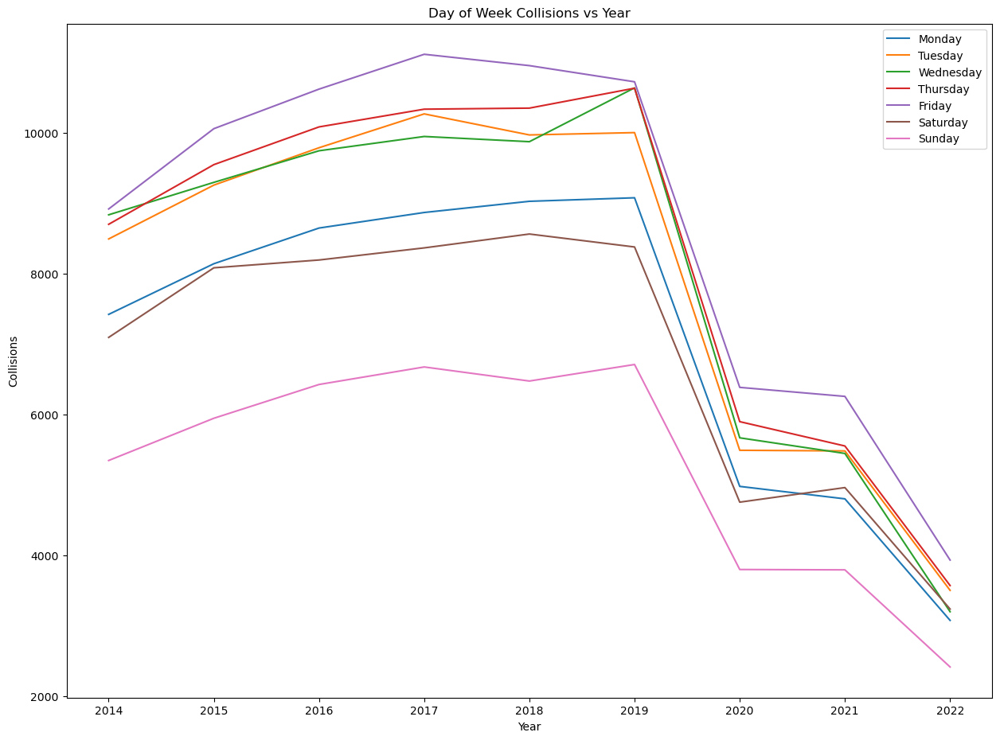

In [51]:
plt.figure(figsize=(15,11))
plt.plot(DoW_final['Year'].loc[DoW_final['DoW']=='Monday'], DoW_final['Count'].loc[DoW_final['DoW']=='Monday'], label = "Monday")
plt.plot(DoW_final['Year'].loc[DoW_final['DoW']=='Tuesday'], DoW_final['Count'].loc[DoW_final['DoW']=='Tuesday'], label = "Tuesday")
plt.plot(DoW_final['Year'].loc[DoW_final['DoW']=='Wednesday'], DoW_final['Count'].loc[DoW_final['DoW']=='Wednesday'], label = "Wednesday")
plt.plot(DoW_final['Year'].loc[DoW_final['DoW']=='Thursday'], DoW_final['Count'].loc[DoW_final['DoW']=='Thursday'], label = "Thursday")
plt.plot(DoW_final['Year'].loc[DoW_final['DoW']=='Friday'], DoW_final['Count'].loc[DoW_final['DoW']=='Friday'], label = "Friday")
plt.plot(DoW_final['Year'].loc[DoW_final['DoW']=='Saturday'], DoW_final['Count'].loc[DoW_final['DoW']=='Saturday'], label = "Saturday")
plt.plot(DoW_final['Year'].loc[DoW_final['DoW']=='Sunday'], DoW_final['Count'].loc[DoW_final['DoW']=='Sunday'], label = "Sunday")

plt.title('Day of Week Collisions vs Year')
plt.xlabel('Year')
plt.ylabel('Collisions')
plt.legend()
plt.show()

#Collisions by Season

In [52]:
season = pd.DataFrame()

season['Year'] = total['Year']
season['season'] = total['Month']

season['season'] = season['season'].map({'December':'Winter','January':'Winter','February':'Winter','March':'Spring','April':'Spring','May':'Spring','June':'Summer','July':'Summer','August':'Summer','September':'Fall','October':'Fall','November':'Fall'})

season


,Year,season
1,2014,Winter
3,2014,Winter
4,2014,Winter
5,2014,Winter
6,2014,Winter
...,...,...
553775,2022,Summer
553776,2022,Summer
553777,2022,Summer
553778,2022,Summer


In [53]:
season.value_counts()

Year  season
2017  Fall      17535
2018  Fall      17405
2019  Winter    17365
2016  Fall      16785
2019  Summer    16645
2017  Summer    16605
2018  Winter    16540
2019  Fall      16486
2018  Summer    16050
2016  Summer    15956
      Winter    15846
2017  Spring    15771
2015  Fall      15723
2019  Spring    15675
2017  Winter    15671
2015  Winter    15545
2018  Spring    15224
2015  Summer    15149
2016  Spring    14922
2014  Fall      14691
      Winter    14159
2015  Spring    13916
2014  Summer    13015
      Spring    12944
2020  Winter    12510
2021  Fall      11832
2022  Spring    10722
2021  Summer     9635
2020  Fall       9263
      Summer     9028
2021  Winter     8054
2022  Winter     7934
2021  Spring     6763
2020  Spring     6163
2022  Summer     4256
dtype: int64

In [54]:
#number of instances 
season_final = season.value_counts()
season_final = pd.DataFrame(season_final).reset_index()
season_final.columns = ['Year', 'Season', 'Count']
season_final = season_final.sort_values(by=['Year'])
season_final = pd.DataFrame(season_final).reset_index()
season_final = season_final.drop(columns=['index'])
season_final

,Year,Season,Count
0,2014,Spring,12944
1,2014,Summer,13015
2,2014,Winter,14159
3,2014,Fall,14691
4,2015,Summer,15149
5,2015,Spring,13916
6,2015,Winter,15545
7,2015,Fall,15723
8,2016,Fall,16785
9,2016,Spring,14922


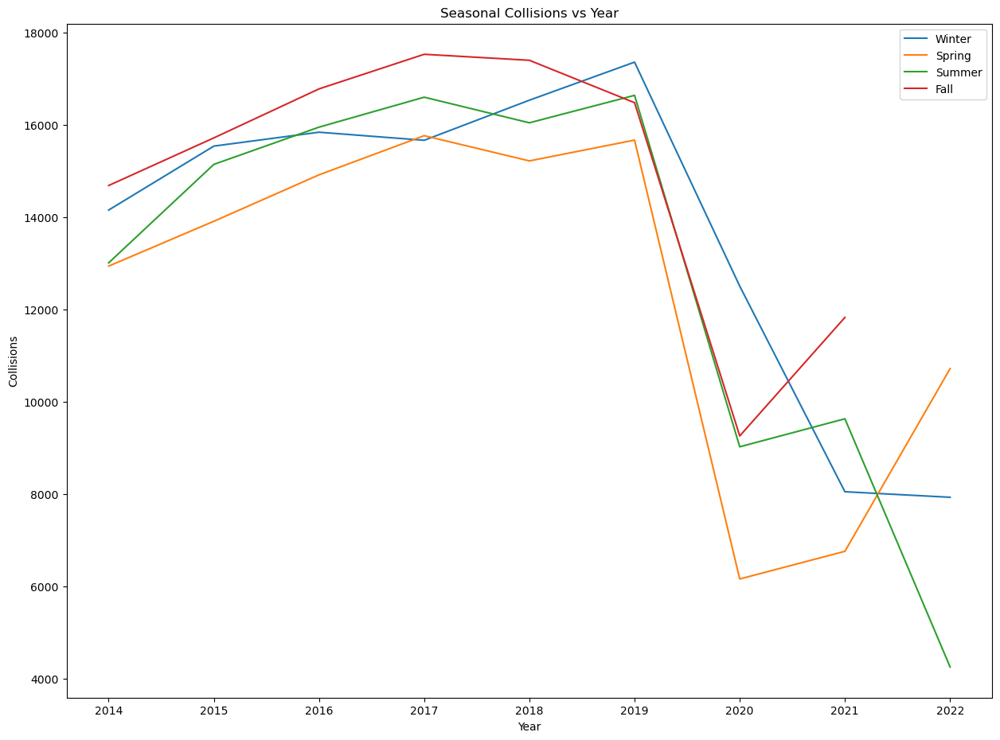

In [55]:
plt.figure(figsize=(15,11))
plt.plot(season_final['Year'].loc[season_final['Season']=='Winter'], season_final['Count'].loc[season_final['Season']=='Winter'], label = "Winter")
plt.plot(season_final['Year'].loc[season_final['Season']=='Spring'], season_final['Count'].loc[season_final['Season']=='Spring'], label = "Spring")
plt.plot(season_final['Year'].loc[season_final['Season']=='Summer'], season_final['Count'].loc[season_final['Season']=='Summer'], label = "Summer")
plt.plot(season_final['Year'].loc[season_final['Season']=='Fall'], season_final['Count'].loc[season_final['Season']=='Fall'], label = "Fall")

plt.title('Seasonal Collisions vs Year')
plt.xlabel('Year')
plt.ylabel('Collisions')
plt.legend()
plt.show()